In [1]:
import numpy as np
from pathlib import Path
import dedalus.public as d3
from mpi4py import MPI
CW = MPI.COMM_WORLD

from dedalus.core import operators
import h5py
import logging
logger = logging.getLogger(__name__)

import matplotlib
import matplotlib.pyplot as plt
matplotlib.rcParams.update({'font.size': 9})
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

plt.rcParams.update({
    "font.family": "sans-serif",
    # Use LaTeX default serif font.
    "font.serif": ["DejaVu Sans"],
})

saturation = 0.97
fig_scales = 3*(3,)
#cases      = ['te601_P1835', 'te60_Pnone']
prefix = 'polished_'
p = Path('../data')
dir_list = [str(x) for x in p.iterdir() if x.is_dir() if x.name.startswith(prefix)]
cases = []
for dd in dir_list:
    parts = dd.split('_')
    cases.append(parts[1]+'_'+parts[2])
    
π      = np.pi
ri, ro = 0.89, 0.99
volume = 4*π * (ro**3 - ri**3 )/3

nHz = 2*π * 1e-9
day = 3600 * 24
Ω0  = 466  * nHz * day

μ0 = 4*π
ρ0 = 0.0309

rsun    = 696e8
u_units = rsun*nHz
b_units = np.sqrt(μ0*ρ0)*u_units

dtype   = np.complex128
φθr     = d3.SphericalCoordinates('φ', 'θ', 'r')
dist    = d3.Distributor(φθr,dtype=dtype,comm=MPI.COMM_SELF)
basis   = d3.ShellBasis(φθr, (2,384,64), radii=(ri,ro), dtype=dtype, dealias=3*(1,))
φ, θ, r = basis.global_grids(dist, scales=(1,1,1))

# auxiliary data

grad    = d3.grad
curl    = d3.curl
div     = d3.div
angular = d3.angular
integ   = d3.integ
lift    = lambda A: d3.Lift(A, basis.clone_with(k=1), -1)

ρ    = dist.Field(bases=basis.meridional_basis, dtype=dtype,name='ρ')
dρ   = dist.VectorField(φθr,bases=basis.meridional_basis, dtype=dtype,name='dρ')
rvec = dist.VectorField(φθr,bases=basis.meridional_basis,name='rvec')

z = (2*r-ri-ro)/(ro-ri)

ρ_coefs    = [ 0.4287056, -0.50122643, 0.07841967, 0.00206746, 0.00243878]
ρ['g']     = ρ0 * np.polynomial.chebyshev.chebval(z,ρ_coefs)

dρ_coefs   = [-9.78493705, 6.46519649, 0.45630896, 0.24012609, 0.11130384]
dρ['g'][2] = ρ0 * np.polynomial.chebyshev.chebval(z,dρ_coefs)

rvec['g'][2] = r

τi = dist.VectorField(φθr,bases=basis.S2_basis(radius=ri),dtype=dtype,name='τi')
τo = dist.VectorField(φθr,bases=basis.S2_basis(radius=ro),dtype=dtype,name='τo')
τχ = dist.Field(dtype=dtype,name='τχ')
χ  = dist.Field(bases=basis,dtype=dtype,name='χ')

u = dist.VectorField(φθr, bases=basis, name='uu')
b = dist.VectorField(φθr, bases=basis, name='bb')

a  = dist.VectorField(φθr, bases=basis, dtype=dtype, name='a')
da = grad(a) + rvec*lift(τi)

problem1 = d3.LBVP([a,χ,τi,τo,τχ],namespace=locals())
problem1.add_equation("trace(da) + τχ = 0")
problem1.add_equation("div(da) + grad(χ) + lift(τo) = -curl(b)")
problem1.add_equation("angular(a(r=ri)) = 0")
problem1.add_equation("angular(a(r=ro)) = 0")
problem1.add_equation("χ(r=ri)  = 0")
problem1.add_equation("χ(r=ro)  = 0")
problem1.add_equation("integ(χ) = 0")

solver1 = problem1.build_solver()

ψ  = dist.VectorField(φθr, bases=basis, dtype=dtype, name='ψ')
dψ = grad(ρ*ψ) + rvec*lift(τi)

problem2 = d3.LBVP([ψ,χ,τi,τo,τχ],namespace=locals())
problem2.add_equation("trace(dψ) + τχ = 0")
problem2.add_equation("div(dψ) + grad(χ) + lift(τo) = - curl(ρ*u)")
problem2.add_equation("angular(ψ(r=ri)) = 0")
problem2.add_equation("angular(ψ(r=ro)) = 0")
problem2.add_equation("χ(r=ri)  = 0")
problem2.add_equation("χ(r=ro)  = 0")
problem2.add_equation("integ(χ) = 0")

solver2 = problem2.build_solver()

/opt/miniconda3/envs/dedalus3/lib/python3.12/site-packages/h5py/__init__.py:36: UserWarning: h5py is running against HDF5 1.14.3 when it was built against 1.14.2, this may cause problems
  _warn(("h5py is running against HDF5 {0} when it was built against {1}, "



te67_Pnone:
γ = 0.0588, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 67 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
2024-03-09 18:11:24,222 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 2m 22s, Remaining: 0s, Rate: 7.0e-03/s
solving: curl(ρψ) = ρu ...
2024-03-09 18:12:36,955 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 1m 12s, Remaining: 0s, Rate: 1.4e-02/s


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te43_Pnone:
γ = 0.0923, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 43 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te41_Pnone:
γ = 0.0958, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 41 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te601_P-1835:
γ = 0.0066,  ω = -0.0135
$\mathrm{t}_{\mathrm{e}}$ = 601 days, $\mathrm{P}\,$ = -1835 days
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te98_Pnone:
γ = 0.0403, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 98 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te38_Pnone:
γ = 0.1032, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 38 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te193_Pnone:
γ = 0.0205, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 193 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te40_Pnone:
γ = 0.0994, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 40 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te64_Pnone:
γ = 0.0622, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 64 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te82_Pnone:
γ = 0.0484, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 82 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te46_Pnone:
γ = 0.0856, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 46 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te86_Pnone:
γ = 0.0461, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 86 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te27_Pnone:
γ = 0.1478, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 27 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te60_Pnone:
γ = 0.0656, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 60 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te44_Pnone:
γ = 0.0889, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 44 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te601_P1835:
γ = 0.0066,  ω = 0.0135
$\mathrm{t}_{\mathrm{e}}$ = 601 days, $\mathrm{P}\,$ = 1835 days
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te48_Pnone:
γ = 0.0823, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 48 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te88_Pnone:
γ = 0.0449, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 88 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te30_Pnone:
γ = 0.1332, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 30 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te91_Pnone:
γ = 0.0432, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 91 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te29_Pnone:
γ = 0.1369, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 29 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:72: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=[7.3,3.5],dpi=600,constrained_layout=True,linewidth=2.0)
/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te934_P2071:
γ = 0.0042,  ω = 0.0120
$\mathrm{t}_{\mathrm{e}}$ = 934 days, $\mathrm{P}\,$ = 2071 days
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te32_Pnone:
γ = 0.1221, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 32 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te36_Pnone:
γ = 0.1108, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 36 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te57_Pnone:
γ = 0.0690, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 57 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te55_Pnone:
γ = 0.0724, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 55 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te1885_P2302:
γ = 0.0021,  ω = 0.0108
$\mathrm{t}_{\mathrm{e}}$ = 1885 days, $\mathrm{P}\,$ = 2302 days
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te95_Pnone:
γ = 0.0414, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 95 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te71_Pnone:
γ = 0.0553, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 71 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te52_Pnone:
γ = 0.0758, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 52 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te1885_P-2302:
γ = 0.0021,  ω = -0.0108
$\mathrm{t}_{\mathrm{e}}$ = 1885 days, $\mathrm{P}\,$ = -2302 days
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te33_Pnone:
γ = 0.1183, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 33 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te76_Pnone:
γ = 0.0519, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 76 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te31_Pnone:
γ = 0.1295, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 31 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te106_Pnone:
γ = 0.0373, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 106 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te28_Pnone:
γ = 0.1406, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 28 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te50_Pnone:
γ = 0.0791, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 50 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te35_Pnone:
γ = 0.1146, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 35 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te934_P-2071:
γ = 0.0042,  ω = -0.0120
$\mathrm{t}_{\mathrm{e}}$ = 934 days, $\mathrm{P}\,$ = -2071 days
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te37_Pnone:
γ = 0.1070, ω = -0.0000
$\mathrm{t}_{\mathrm{e}}$ = 37 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')



te72_Pnone:
γ = 0.0546, ω = 0.0000
$\mathrm{t}_{\mathrm{e}}$ = 72 days, $\mathrm{P}\,$ = None
--------------------------------------------------
solving: curl(a) = b ...
solving: curl(ρψ) = ρu ...


/var/folders/8j/kcmh8b0d37lgd3dff3rz5wsc0000gn/T/ipykernel_9778/1084362841.py:130: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')
/opt/miniconda3/envs/dedalus3/lib/python3.12/site-packages/IPython/core/events.py:82: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  func(*args, **kwargs)


2024-03-09 18:18:04,962 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:05,814 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:06,666 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:07,560 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:08,465 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:09,419 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:10,720 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:11,732 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:12,660 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:13,582 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode
2024-03-09 18:18:14,

/opt/miniconda3/envs/dedalus3/lib/python3.12/site-packages/IPython/core/pylabtools.py:152: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.canvas.print_figure(bytes_io, **kw)


2024-03-09 18:18:44,409 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


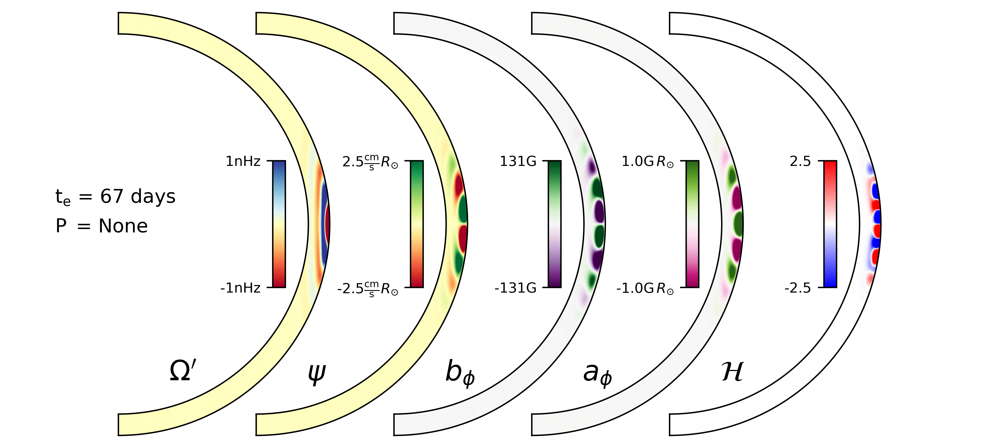

2024-03-09 18:18:46,199 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


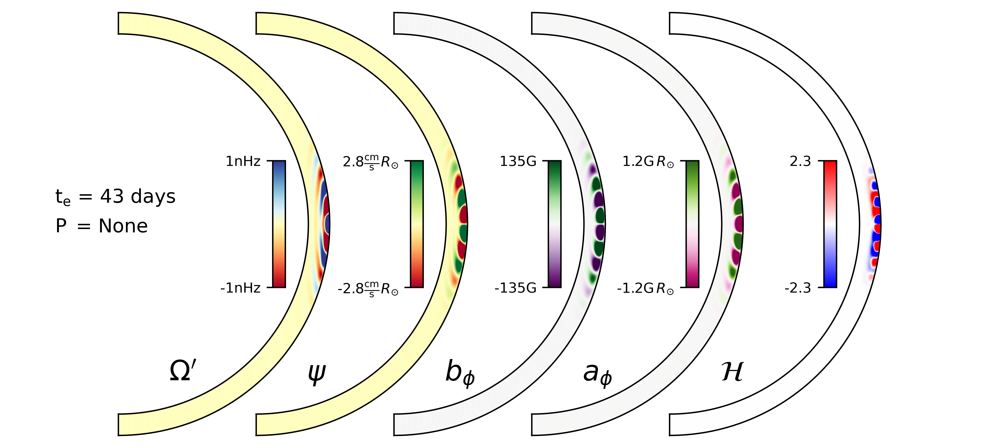

2024-03-09 18:18:47,874 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


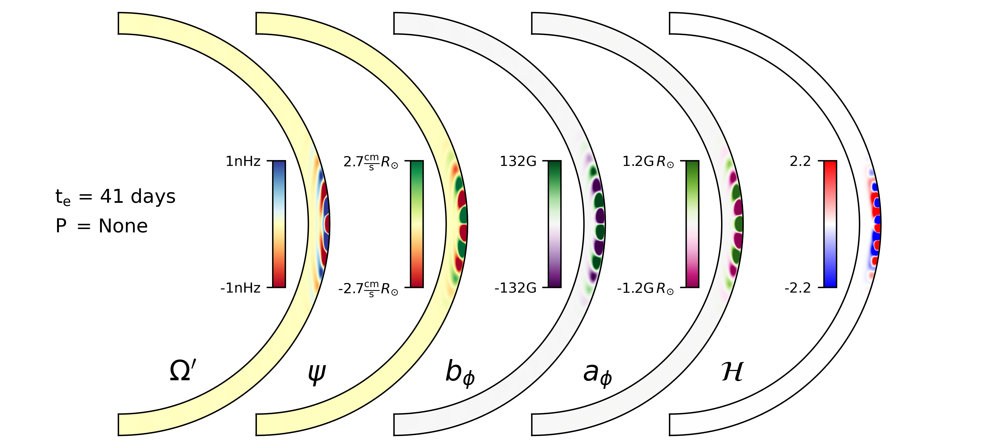

2024-03-09 18:18:49,513 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


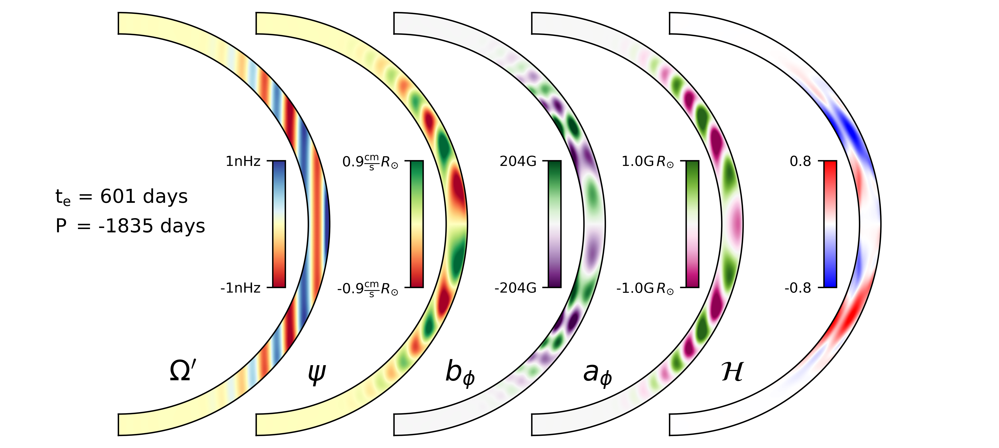

2024-03-09 18:18:51,230 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


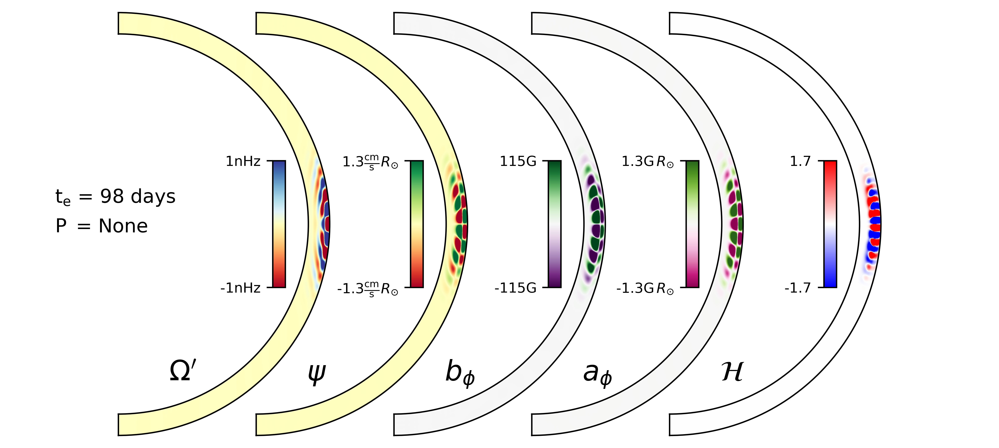

2024-03-09 18:18:52,837 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


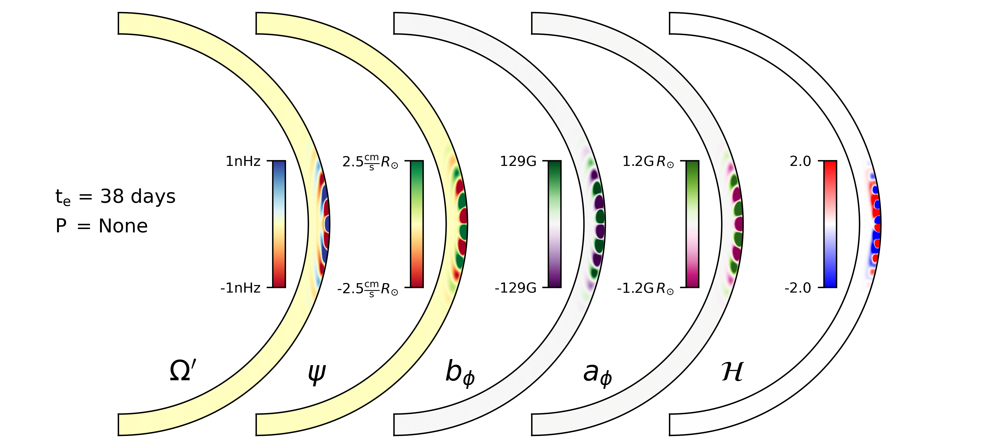

2024-03-09 18:18:54,517 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


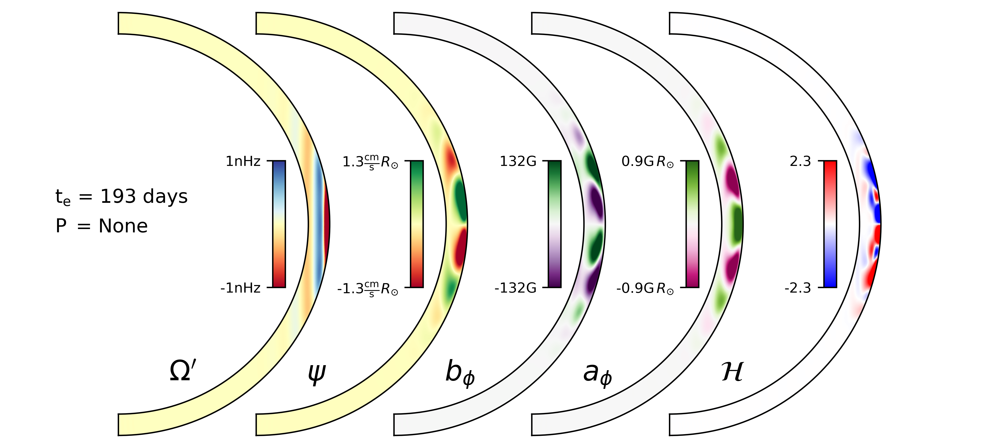

2024-03-09 18:18:56,158 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


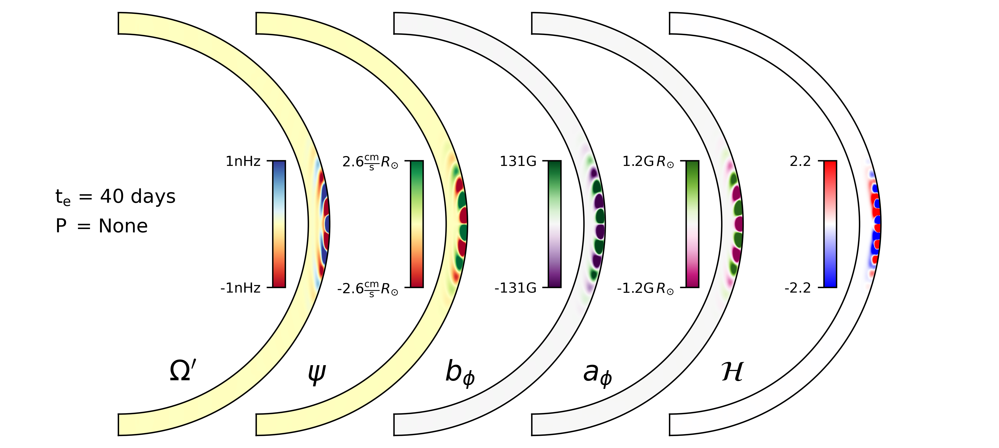

2024-03-09 18:18:57,838 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


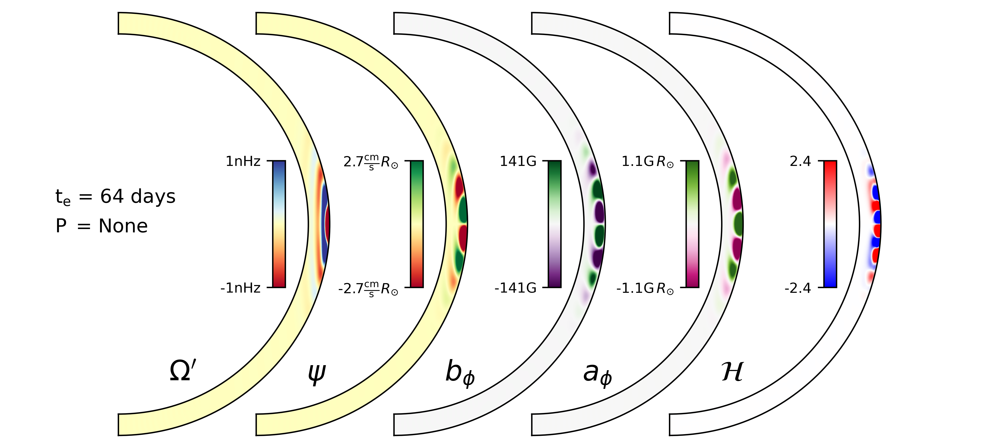

2024-03-09 18:18:59,494 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


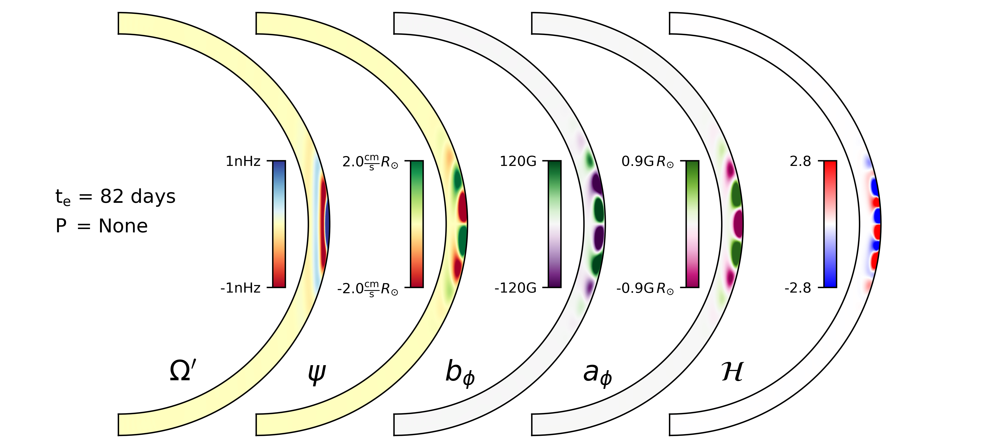

2024-03-09 18:19:01,137 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


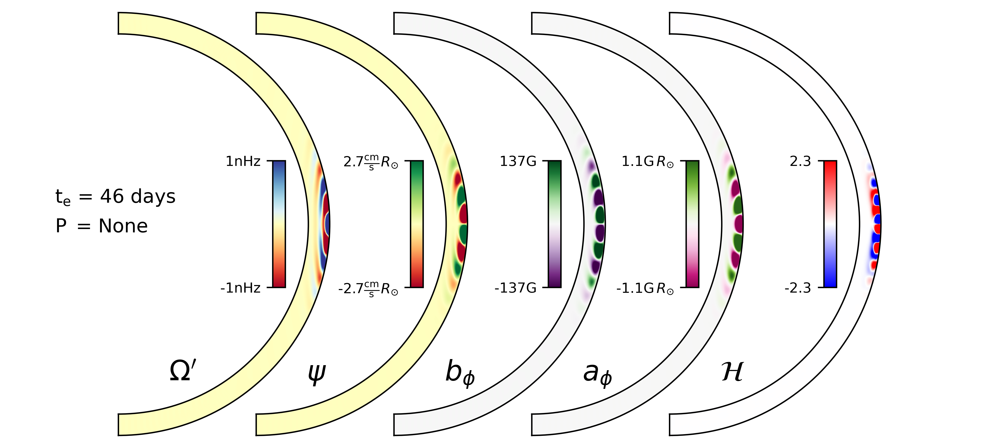

2024-03-09 18:19:02,785 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


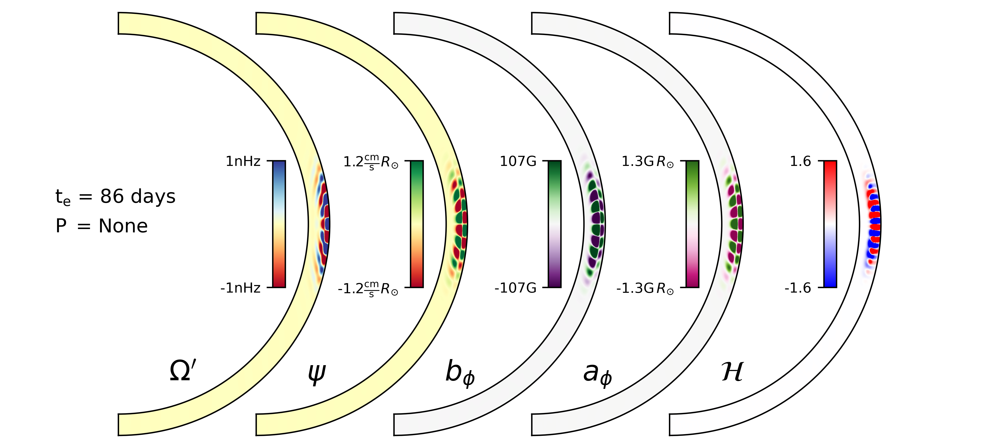

2024-03-09 18:19:04,474 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


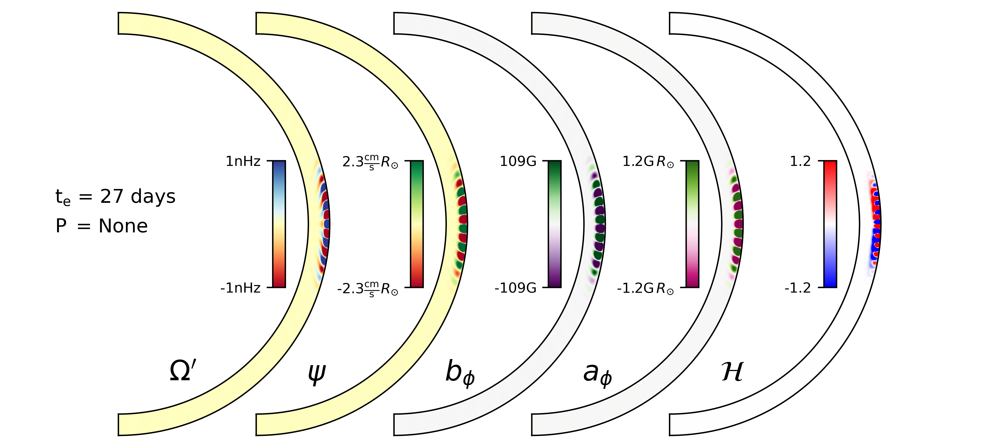

2024-03-09 18:19:06,101 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


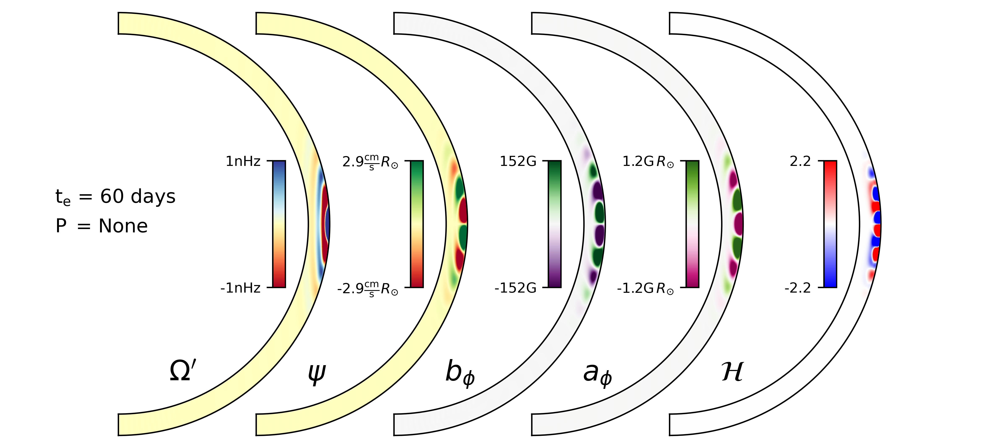

2024-03-09 18:19:07,777 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


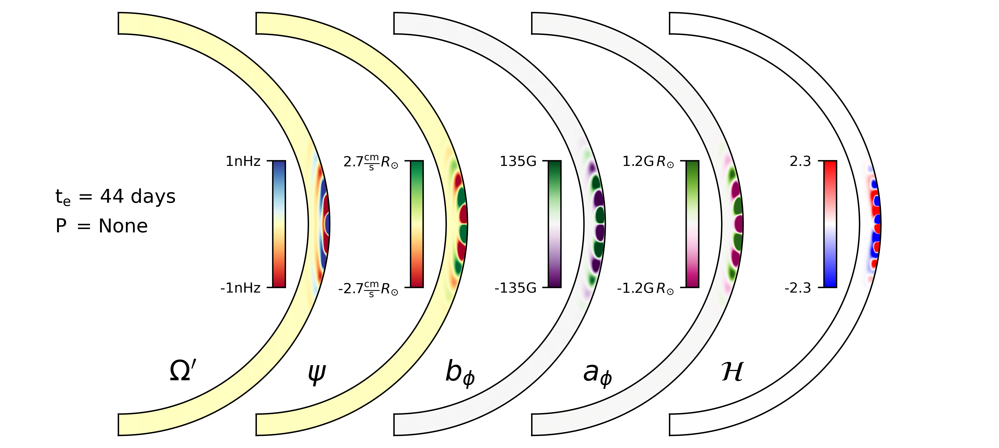

2024-03-09 18:19:09,403 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


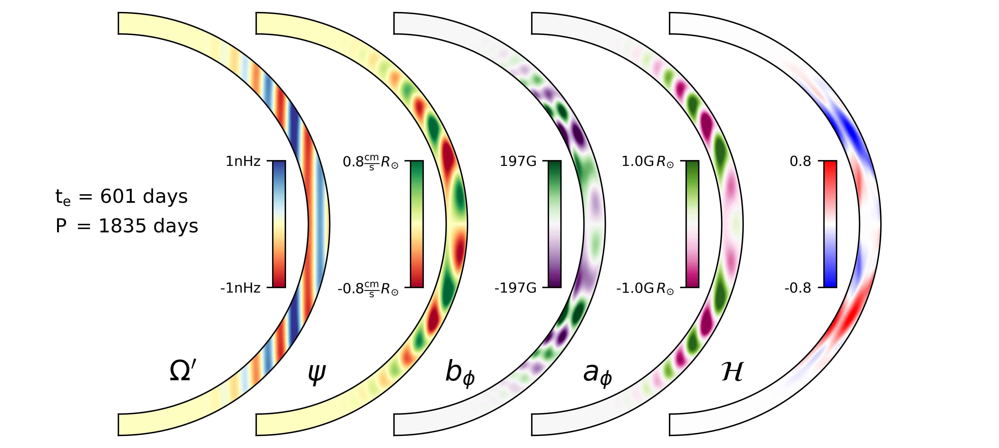

2024-03-09 18:19:11,155 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


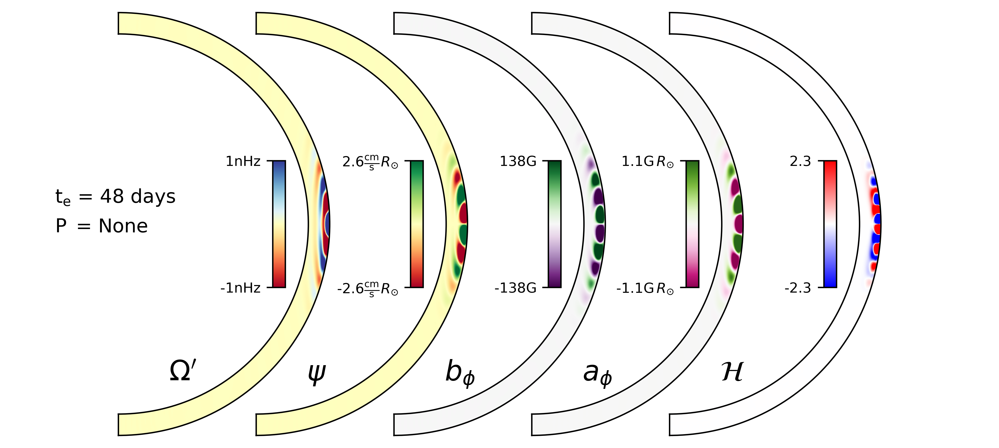

2024-03-09 18:19:12,799 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


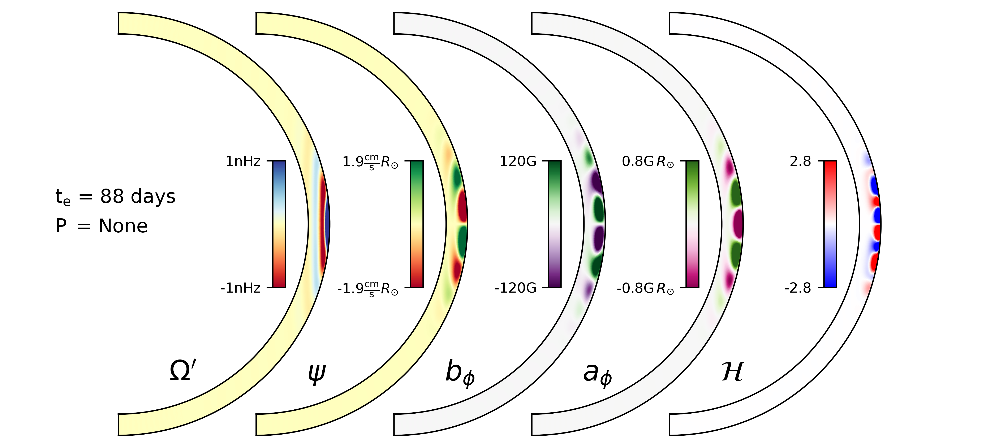

2024-03-09 18:19:14,488 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


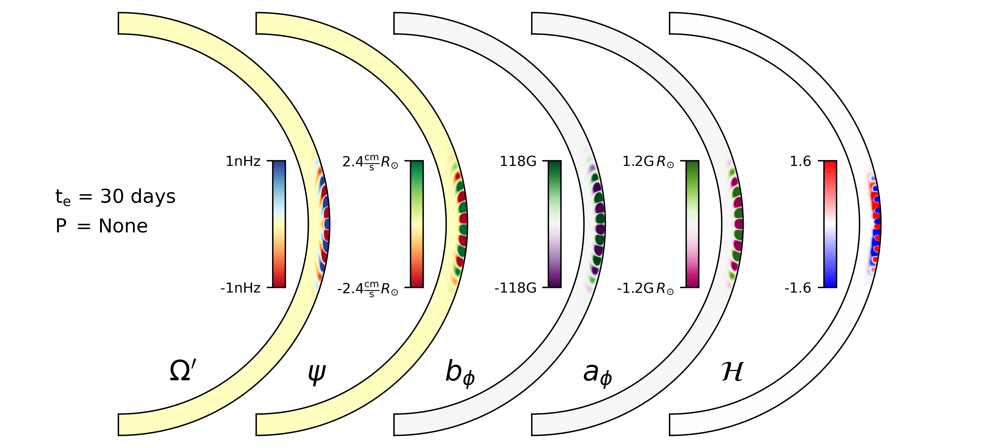

2024-03-09 18:19:16,173 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


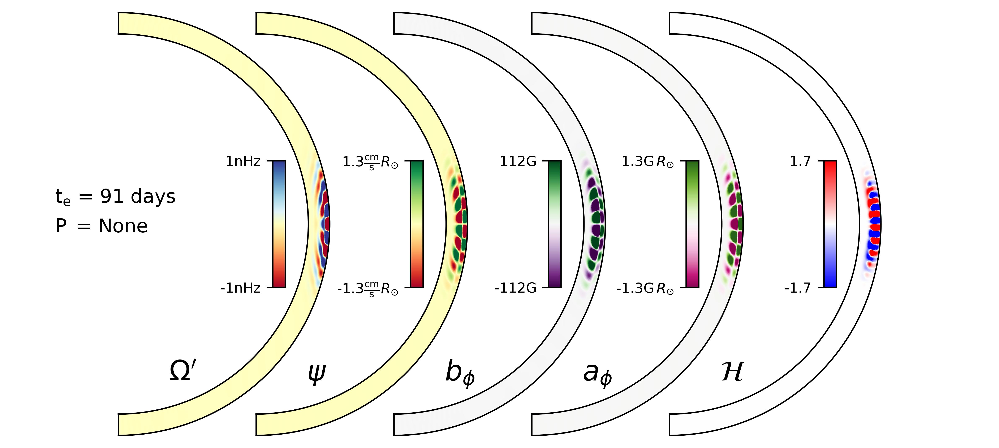

2024-03-09 18:19:17,962 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


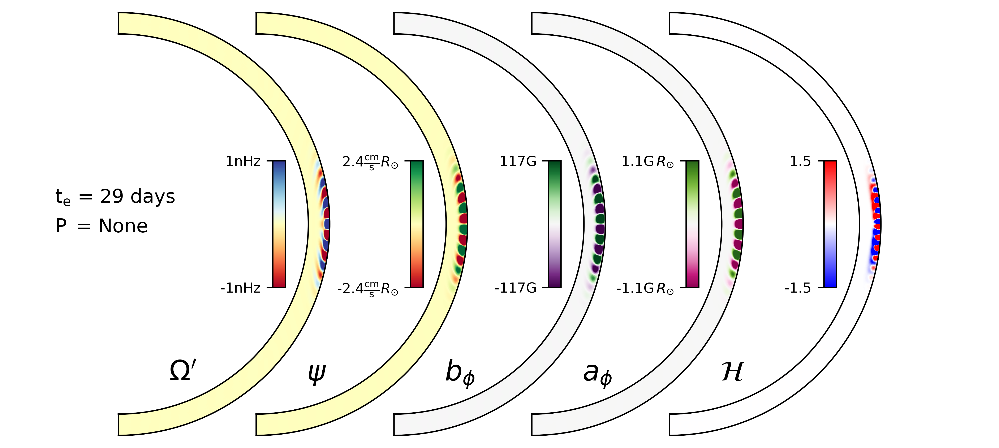

2024-03-09 18:19:19,605 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


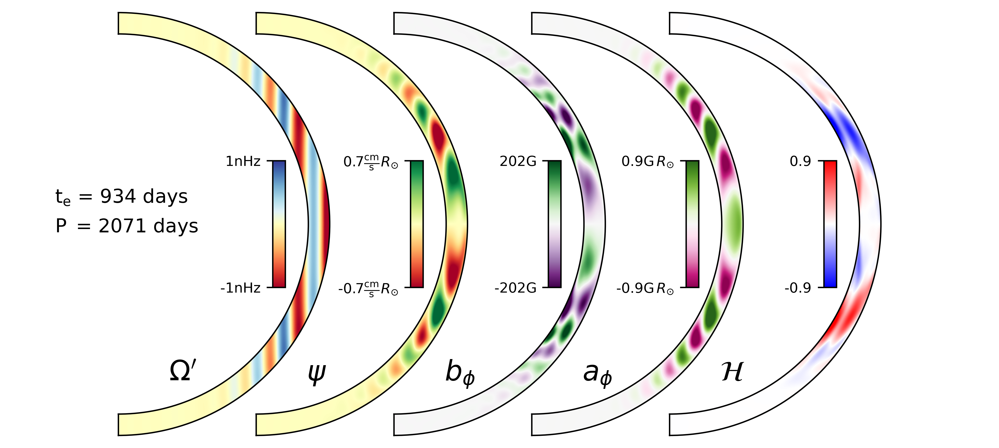

2024-03-09 18:19:21,331 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


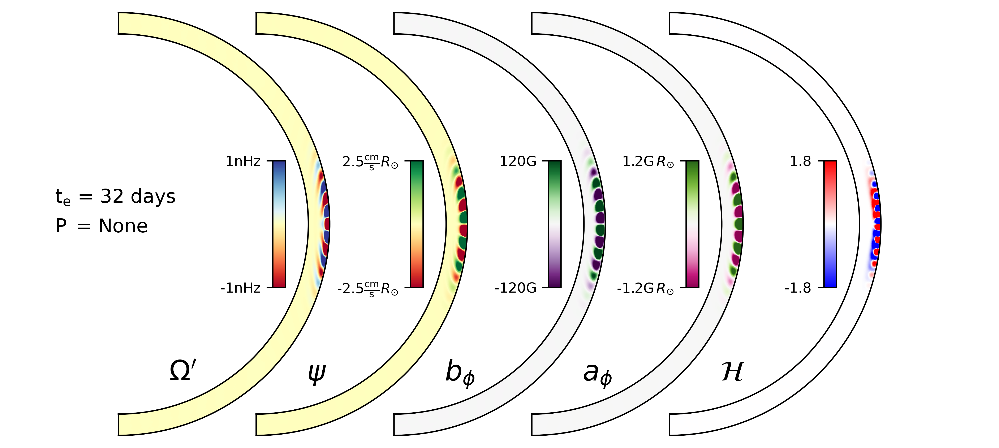

2024-03-09 18:19:22,972 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


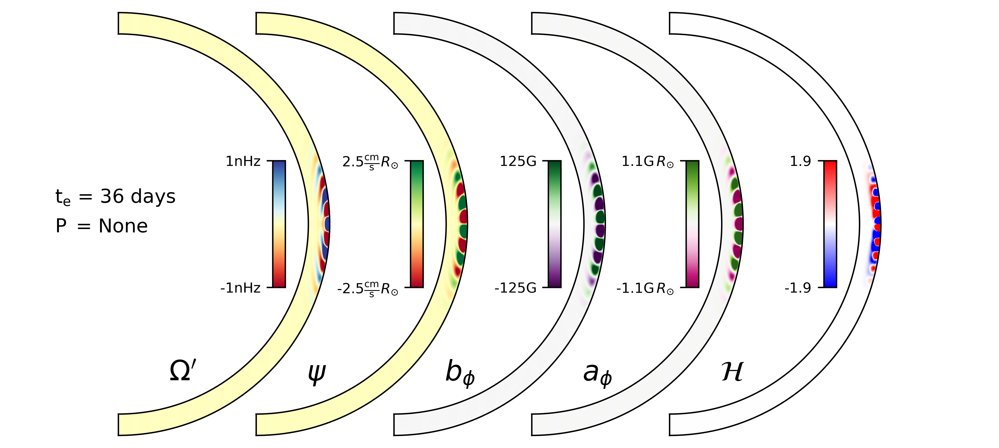

2024-03-09 18:19:24,604 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


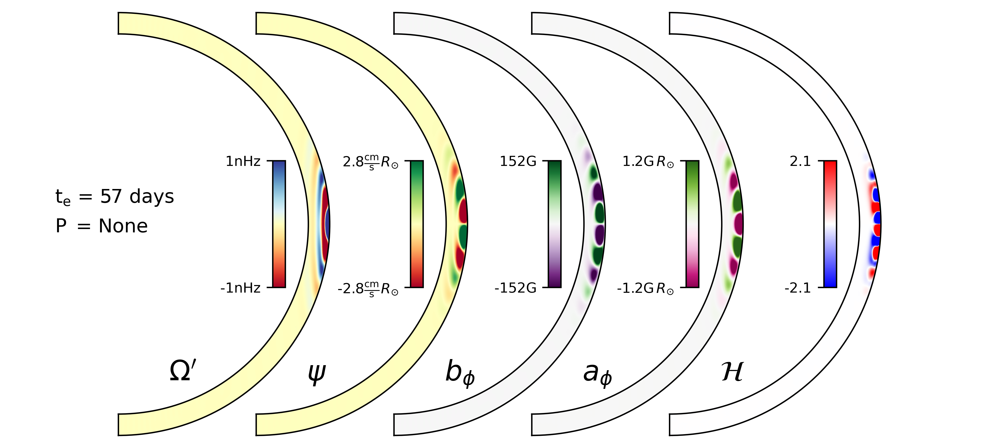

2024-03-09 18:19:26,216 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


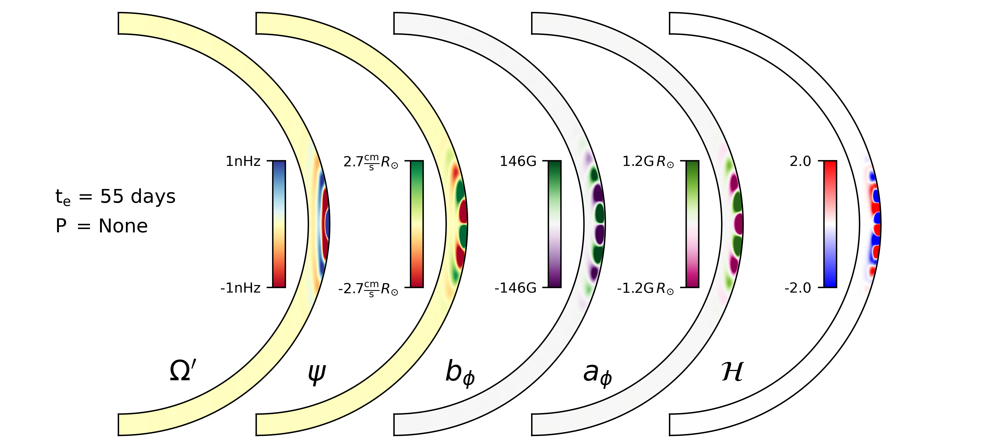

2024-03-09 18:19:27,905 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


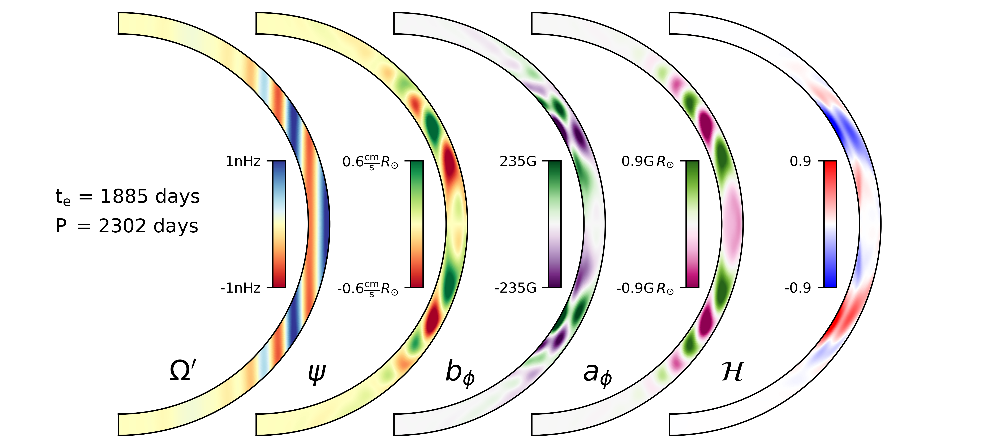

2024-03-09 18:19:29,646 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


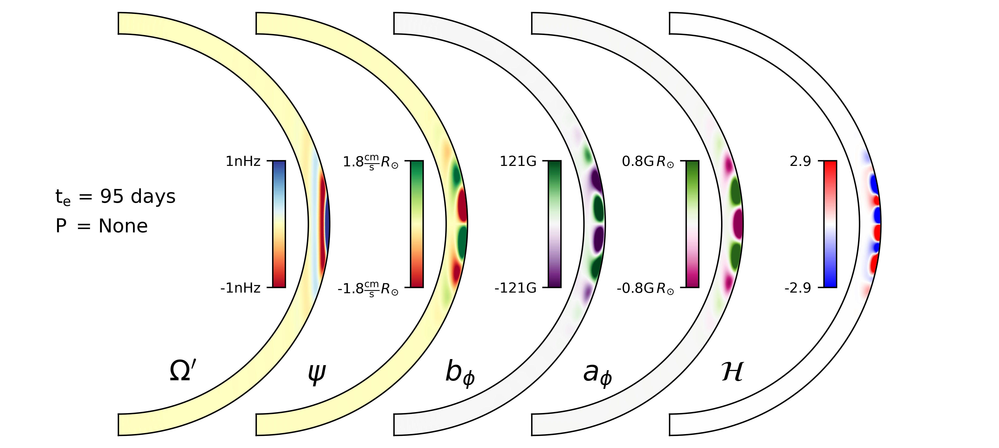

2024-03-09 18:19:31,360 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


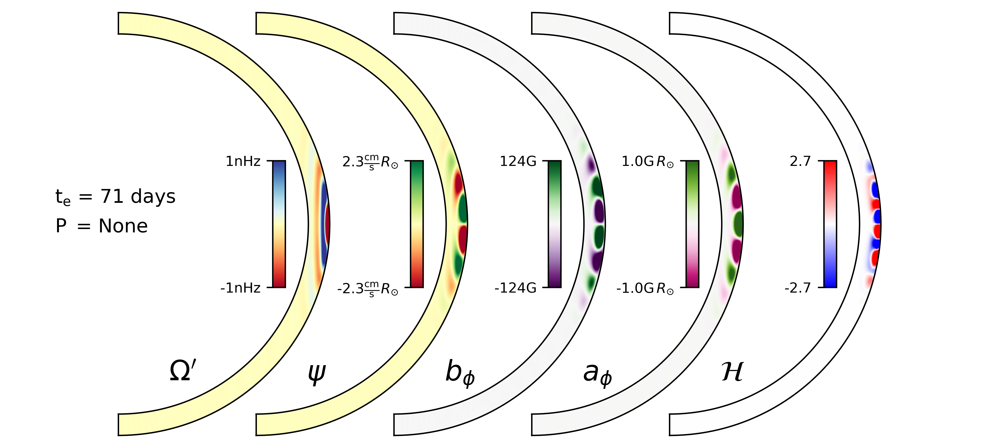

2024-03-09 18:19:33,038 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


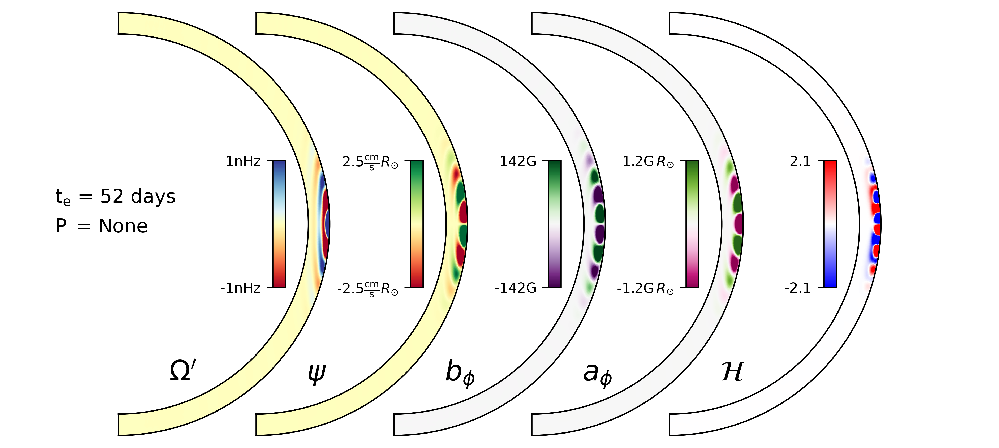

2024-03-09 18:19:34,683 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


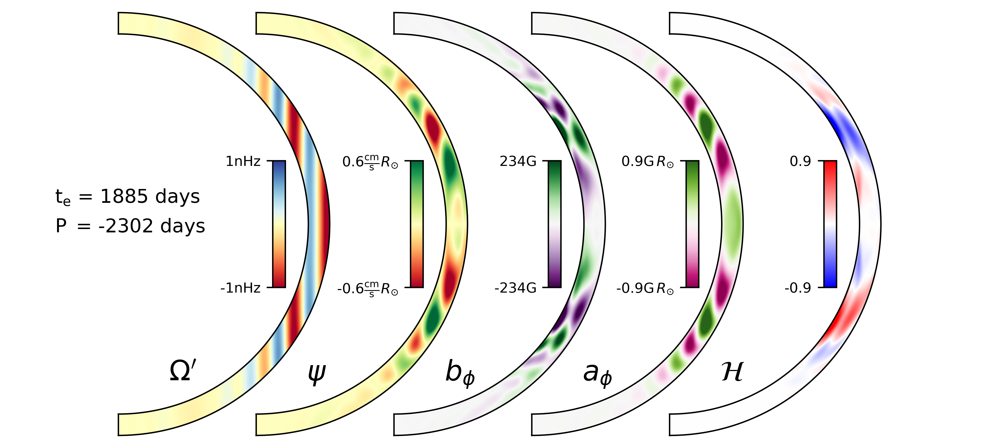

2024-03-09 18:19:36,463 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


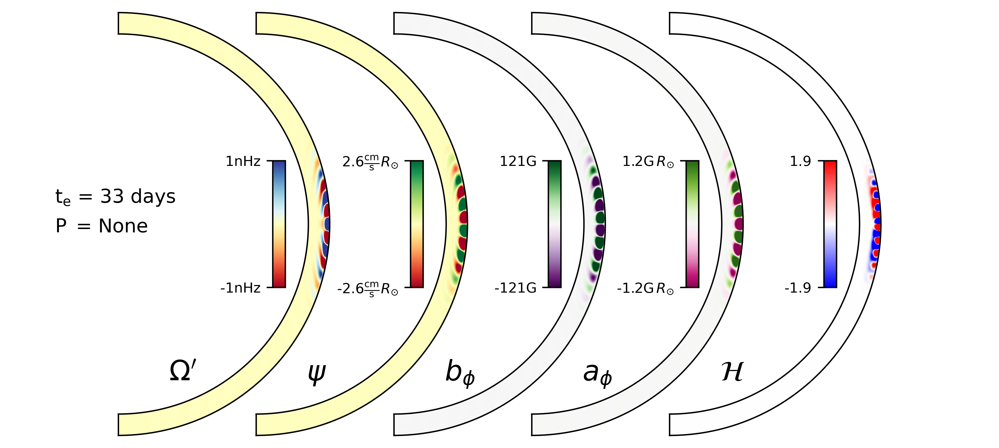

2024-03-09 18:19:38,098 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


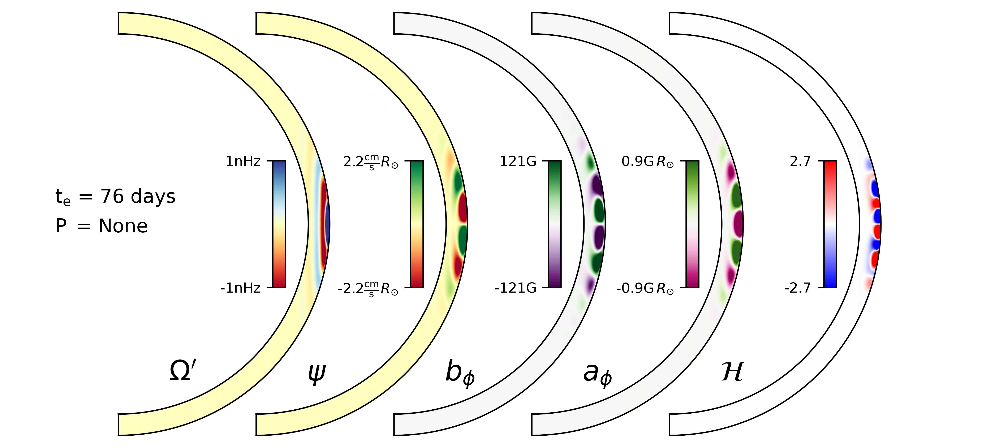

2024-03-09 18:19:39,809 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


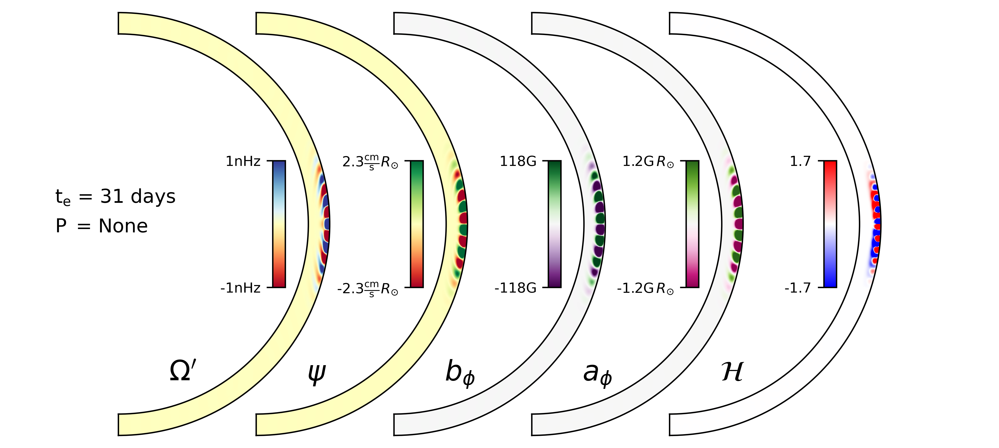

2024-03-09 18:19:41,452 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


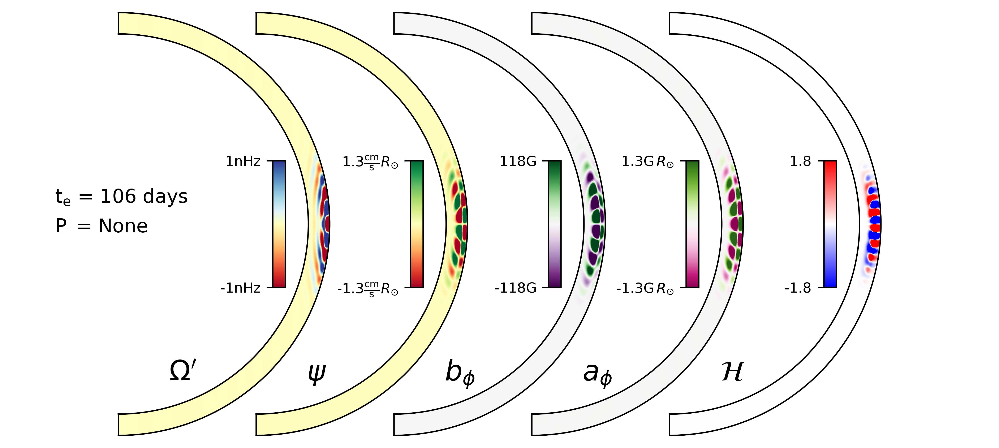

2024-03-09 18:19:43,094 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


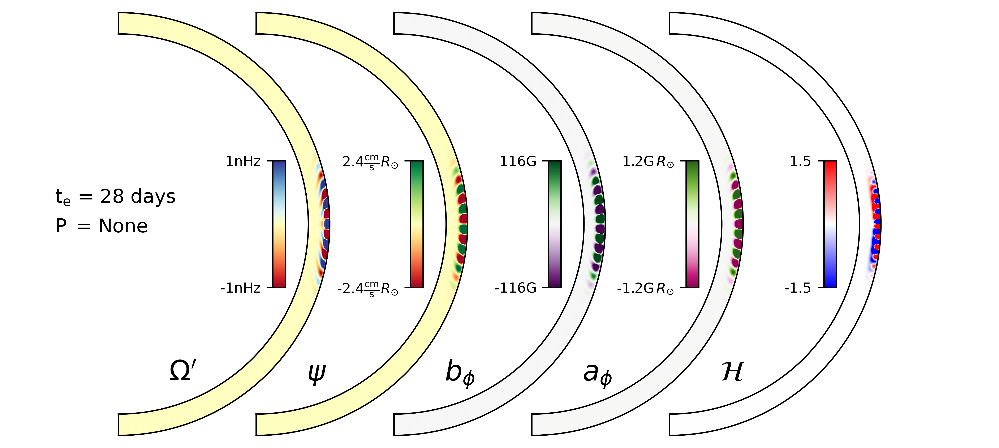

2024-03-09 18:19:44,742 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


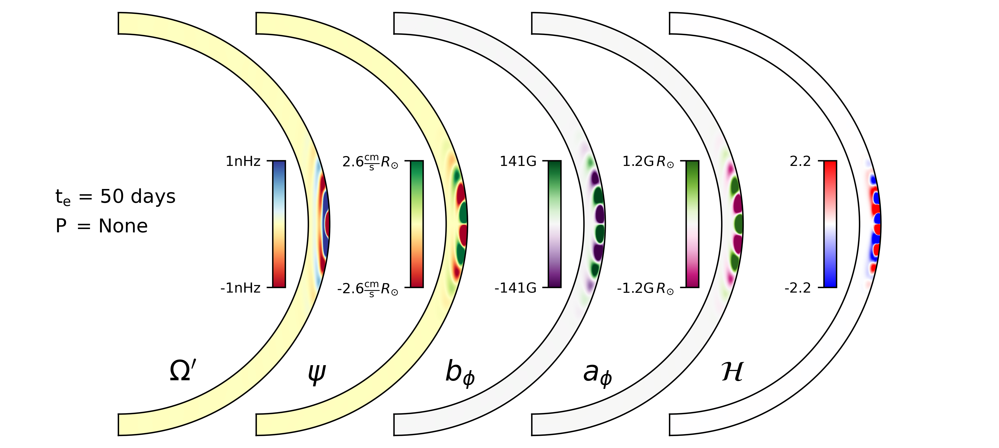

2024-03-09 18:19:46,398 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


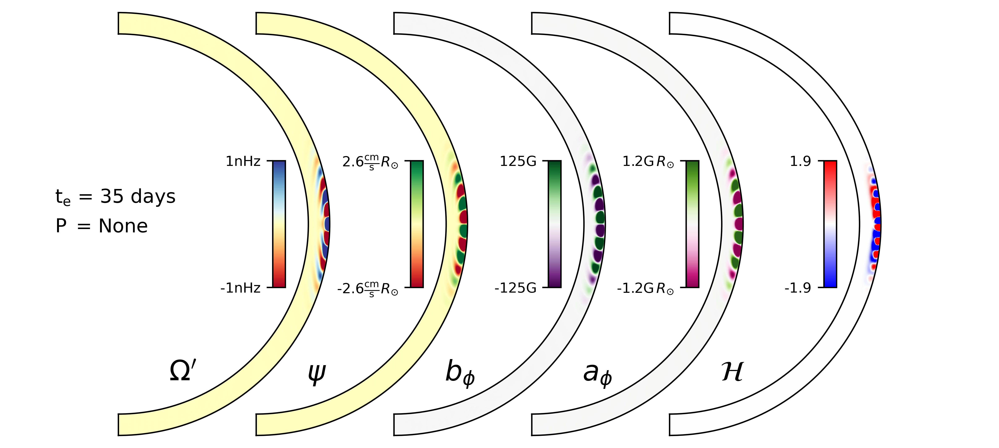

2024-03-09 18:19:48,052 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


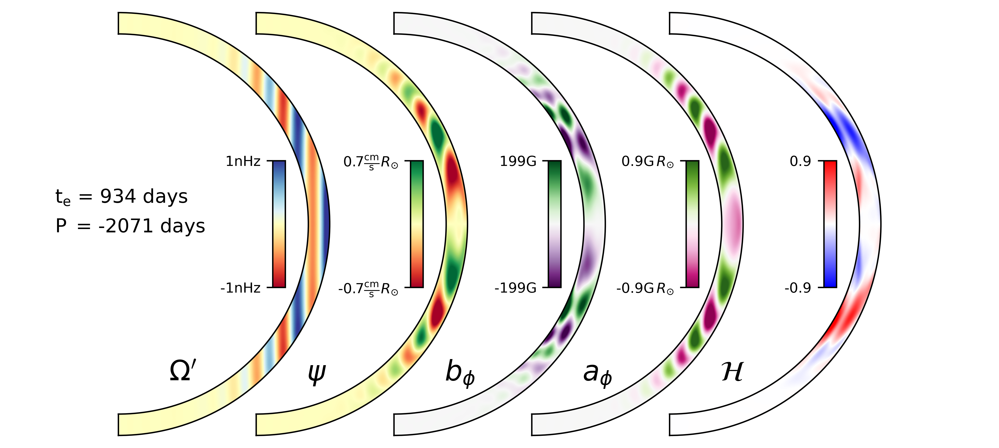

2024-03-09 18:19:49,797 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


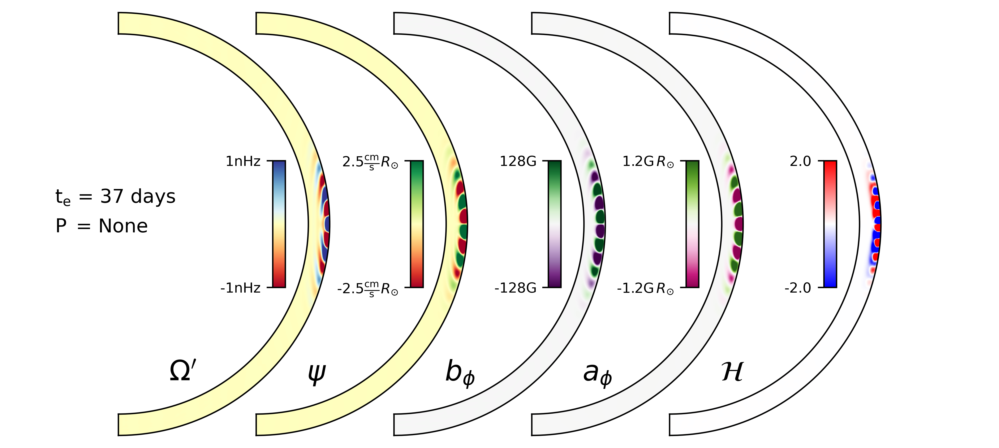

2024-03-09 18:19:51,434 matplotlib.mathtext 0/1 INFO :: Substituting symbol H from STIXNonUnicode


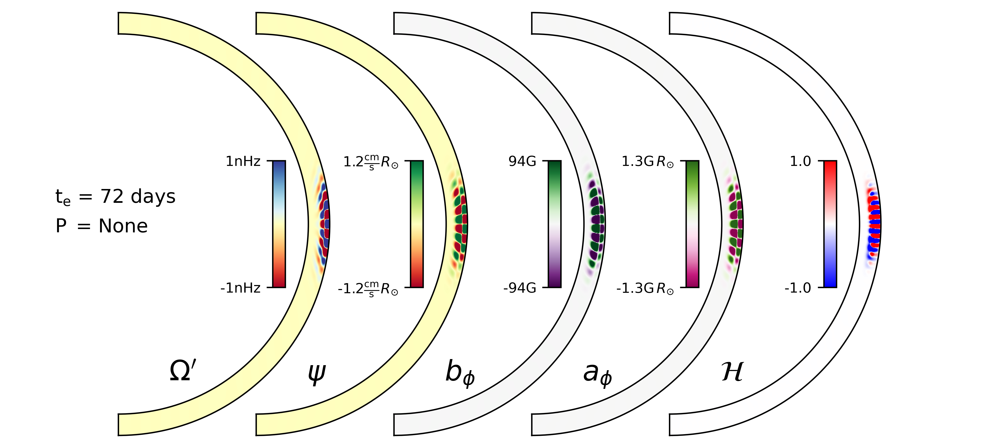

In [2]:
ncase = len(cases)
myrank = CW.rank
size = CW.size
for kk in range(myrank,ncase,size):
    case = cases[kk]
    eig = np.load('../data/' + prefix + case + '/eigs.npy')
    γ, ω = eig[0].imag, eig[0].real

    file = h5py.File('../data/' + prefix + case + '/checkpoints/checkpoints_s1.h5')

    growth =   1 / (γ*Ω0)
    period = 2*π / (ω*Ω0)

    if np.abs(period) > 1000*growth:
        period, gap = r'$\mathrm{P}\,$ ' + '= None', ', '
    else:
        period, gap = r'$\mathrm{P}\,$ ' + f'= {period:.0f} days', ',  '

    #growth = f'τ = {growth:.0f} days'
    growth = r'$\mathrm{t}_{\mathrm{e}}$ = ' + f'{growth:.0f} days'

    print()
    print(case + ':')
    print(f'γ = {γ:.4f}' + gap + f'ω = {ω:.4f}')
    print(growth + ', ' + period)
    print(50*'-')
    
    for f in [u,b,a,ψ]:
        f.change_scales(1)

    u.require_grid_space()
    b.require_grid_space()
    u.load_from_hdf5(file,0)
    b.load_from_hdf5(file,0)

    b['g'] *= b_units/np.max(np.abs(u['g']))
    u['g'] *= u_units/np.max(np.abs(u['g']))
    
    print('solving: curl(a) = b ...')
    solver1.solve()

    print('solving: curl(ρψ) = ρu ...')
    solver2.solve()
    
    b_conj = dist.VectorField(φθr, bases=basis, dtype=dtype, name='b_conj')

    b.change_scales(fig_scales)
    b_conj.change_scales(fig_scales)

    b_conj['g'] = b['g'].conjugate()
    j, j_conj   = curl(b), curl(b_conj)

    H  = 0.5 * volume * (b_conj @ j + b @ j_conj )
    H /= (integ(b_conj @ b) * integ(j_conj @ j))**(1/2)
    H  = H.evaluate()

    φ, θ, r = basis.global_grids(dist, scales=fig_scales)
    for f in [u,b,a,ψ,H]:
        f.change_scales(fig_scales)

    δΩ  = (u['g'][0]/(rsun*nHz*r*np.sin(θ)))[0].real

    vals  = np.sort(np.abs(δΩ.flatten()))
    Ω_sat = vals[int(saturation*len(vals))]
    δΩ   /=  Ω_sat

    ψφ = ψ['g'][0,0].real/Ω_sat
    aφ = a['g'][0,0].real/Ω_sat
    bφ = b['g'][0,0].real/Ω_sat
    Ha = H['g'][0].real
    
    fig = plt.figure(figsize=[7.3,3.5],dpi=600,constrained_layout=True,linewidth=2.0)
    data = [δΩ, ψφ, bφ, aφ, Ha]
    x, y = np.meshgrid(θ,r)

    labels = [r"$\Omega'$",
               r'$\psi$',
               r'$b_{\phi}$',
               r'$a_{\phi}$',
               r'$\mathcal{H}$']

    unit  = [r'$\mathrm{nHz}$',
             r'$\mathrm{\frac{cm}{s}} R_{\odot}$',
             r'$\mathrm{G}$',
             r'$\mathrm{G}\,R_{\odot}$','']

    cmaps = ['RdYlBu','RdYlGn','PRGn','PiYG','bwr']

    def style(index,value):
            if labels[index] in [r'$\psi$', r'$a_{\phi}$', r'$\mathcal{H}$']:
                return '{:.1f}'.format(value) + unit[index]
            return '{:.0f}'.format(value) + unit[index]

    for ii in range(5):
        pos = [ 0.15 * ii - 0.265, 0.02, 0.92, 0.96 ]
        pb = fig.add_axes(pos,projection='polar')
        pb.set_xticklabels([])
        pb.set_yticklabels([])
        pb.set_xticks([])
        pb.set_yticks([])

        vals = np.sort(np.abs(data[ii].flatten()))
        vmax = vals[int(saturation*len(vals))]

        meplot = pb.pcolormesh(x, y, data[ii].T,
                               cmap =  cmaps[ii], vmin = -vmax, vmax =  vmax,
                               rasterized =  True, shading    =  'auto')

        pb.set_theta_direction(-1)
        pb.set_theta_offset(π/2)
        pb.set_thetalim([π,0])
        pb.set_rlim(ri,ro)
        pb.set_rorigin(0)
        pb.set_aspect(1)
        pb.grid(False)

        cbax = inset_axes(pb, width = "3%", height = "30%", loc = 'center',
                          bbox_to_anchor = [0.13, 0, 1, 1], bbox_transform = pb.transAxes)

        mycbar = fig.colorbar(meplot,cax=cbax,orientation='vertical',ticks=[-vmax,vmax])
        cbax.yaxis.set_ticks_position('left')

        cbax.set_yticklabels( [style(ii, -vmax), style(ii, vmax)], fontsize = 8)
        pb.text(0.37, 0.13, labels[ii], transform = pb.transAxes, fontsize = 16)

        if ii == 0 :
            pb.text(0.1, 0.55, growth, transform = pb.transAxes, fontsize = 11)
            pb.text(0.1, 0.48, period, transform = pb.transAxes, fontsize = 11)

    fig.savefig('../pdf/' + case + '.pdf', backend='pgf', bbox_inches='tight')